![image](https://docs.google.com/uc?export=download&id=1Nh6vjig-ADM1RMbaHrj_GItD3O1ZW4Vr)
# Análisis con Machine Learning - MINE4206
<table align="center">
  <td>
    <a href="https://colab.research.google.com/github/jpcano1/MINE_4206_Analisis_con_Machine_Learning/blob/main/Lab%20V/Lab_V.ipynb" target="_blank"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
  </td>
</table>




## Objetivos

*   Describir y analizar técnicas de aprendizaje no supervisado.
*   Implementar técnicas de detección de anomalías.

## **Nombres de los Integrantes**
- **Integrante 1**: 
- **Integrante 2**:
- **Integrante 3**:



## Primer Problema
Una de las fuentes más comunes para obtener un análisis de sentimientos de una sociedad es a través de artículos que publican diferentes fuentes periodísticas. Para ello, le han pedido obtener las principales palabras o características presentes en los diferentes artículos publicados, para poder entender y establecer cuales temas eran los más comentados en la sociedad británica por el año 2005.

Para el entrenamiento de este modelo, se va a utilizar noticias publicadas por la BBC y se han clasificado previamente en 5 categorías: Negocios, Entretenimiento, Política, Deportes y Tecnología.



### Importando las librerias requeridas para el desarrollo del laboratorio


In [1]:
!pip install -q https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     \ 38.4MB 104.5MB/s
     |████████████████████████████████| 112kB 13.2MB/s 
     |████████████████████████████████| 1.1MB 35.9MB/s 
     |████████████████████████████████| 3.1MB 34.7MB/s 
     |████████████████████████████████| 61kB 6.0MB/s 
     |████████████████████████████████| 81kB 7.7MB/s 
     |████████████████████████████████| 296kB 30.9MB/s 
ERROR: google-colab 1.0.0 has requirement requests~=2.23.0, but you'll have requests 2.25.1 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: phik 0.11.2 has requirement scipy>=1.5.2, but you'll have scipy 1.4.1 which is incompatible.


In [2]:
import pandas as pd
import numpy as np
import sys
from pandas_profiling import ProfileReport
import os
import os.path as osp


from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import classification_report
from sklearn.compose import make_column_selector,  make_column_transformer
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import IsolationForest

import matplotlib.pyplot as plt
import seaborn as sns

### Perfilamiento y entendimiento de los datos


#### Lectura de los datos
Como cada artículo está separado en una carpeta diferente, primero se recorre todas las carpetas y dentro de las carpetas se leen los archivos y se guardan en una tabla con las columnas (Categoría, Texto)

In [3]:
!git clone https://github.com/jpcano1/MINE_4206_Analisis_con_Machine_Learning

Cloning into 'MINE_4206_Analisis_con_Machine_Learning'...
remote: Enumerating objects: 2371, done.
remote: Counting objects: 100% (2371/2371), done.
remote: Compressing objects: 100% (2305/2305), done.
remote: Total 2371 (delta 67), reused 2339 (delta 35), pack-reused 0
Receiving objects: 100% (2371/2371), 20.61 MiB | 11.35 MiB/s, done.
Resolving deltas: 100% (67/67), done.


In [4]:
datos = pd.DataFrame(columns=['Categoria','Texto'])

path = osp.join('MINE_4206_Analisis_con_Machine_Learning','Lab VII','data','Punto 1','Noticias BBC')
categorias = os.listdir(path)
for cat in categorias:
    if cat.startswith('.'): continue
    articulos = os.listdir(osp.join(path,cat))
    for x in articulos:
        texto = open(osp.join(path,cat,x),'r',encoding='unicode_escape').read()
        
        datos = datos.append({'Categoria':cat,'Texto':texto},ignore_index=True)

print(datos.shape)

display(datos.head())


(2225, 2)


,Categoria,Texto
0,entertainment,Elton plays Paris charity concert\n\nSir Elton...
1,entertainment,"Pixies take on Reading and Leeds\n\nPixies, Fo..."
2,entertainment,Actor Scott is new Bond favourite\n\nBookmaker...
3,entertainment,Musical treatment for Capra film\n\nThe classi...
4,entertainment,US 'to raise TV indecency fines'\n\nUS politic...


#### Preprocesamiento de los Datos

Para la transformación, en este caso como vamos a determinar la importancia de diferentes palabras dentro de los documentos y cuales son las más significativas entre las categorías, se decide utilizar la transformación [Tf-idf](https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfTransformer.html#sklearn.feature_extraction.text.TfidfTransformer).

In [5]:
vectorizer = TfidfVectorizer(stop_words="english")
X = pd.DataFrame(vectorizer.fit_transform(datos['Texto']).toarray())
X.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,29086,29087,29088,29089,29090,29091,29092,29093,29094,29095,29096,29097,29098,29099,29100,29101,29102,29103,29104,29105,29106,29107,29108,29109,29110,29111,29112,29113,29114,29115,29116,29117,29118,29119,29120,29121,29122,29123,29124,29125
0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.064652,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Modelamiento

Para cumplir el primer objetivo, utilizamos un aprendizaje no supervisado, ya que lo que queremos es obtener las propiedades principales de cada uno de los textos. En este caso se puede utilizar el algoritmo de K-Means.

In [6]:
k = 5
model = KMeans(n_clusters=k,random_state=11)
model.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=11, tol=0.0001, verbose=0)

In [7]:
order_centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()

pred = model.labels_
categorias = datos['Categoria'].unique()


tabla = dict()
for i in range(k):
    tabla[i] = [terms[ind] for ind in order_centroids[i, :10]]
    
pd.DataFrame(tabla)

,0,1,2,3,4
0,film,said,people,mr,game
1,best,growth,mobile,labour,england
2,awards,year,said,election,win
3,said,mr,technology,blair,said
4,award,economy,software,said,cup
5,music,government,users,party,match
6,band,bank,music,brown,team
7,year,market,digital,government,players
8,album,company,phone,howard,injury
9,festival,sales,net,minister,play


### Validación

In [8]:
inverso = dict()
for x in categorias:
    d = pd.Series(pred[datos['Categoria']==x])
    print('Categoria: %s' % x)
    print(d.value_counts())
    num = d.value_counts().index[0]
    inverso[num] = x

print(inverso)


Categoria: entertainment
0    369
1     12
2      5
dtype: int64
Categoria: tech
2    364
4     15
1     15
0      7
dtype: int64
Categoria: business
1    497
2      9
3      2
4      1
0      1
dtype: int64
Categoria: politics
3    277
1    129
2      4
0      4
4      3
dtype: int64
Categoria: sport
4    483
0     26
1      2
dtype: int64
{0: 'entertainment', 2: 'tech', 1: 'business', 3: 'politics', 4: 'sport'}


In [9]:
tabla = dict()
for i in range(k):
    tabla[inverso[i]] = [terms[ind] for ind in order_centroids[i, :10]]
    
pd.DataFrame(tabla)

,entertainment,business,tech,politics,sport
0,film,said,people,mr,game
1,best,growth,mobile,labour,england
2,awards,year,said,election,win
3,said,mr,technology,blair,said
4,award,economy,software,said,cup
5,music,government,users,party,match
6,band,bank,music,brown,team
7,year,market,digital,government,players
8,album,company,phone,howard,injury
9,festival,sales,net,minister,play


## Segundo Problema

Los datos empleados en este documento se han obtenido de Outlier Detection DataSets (ODDS), un repositorio con datos comúnmente empleados para comparar la capacidad que tienen diferentes algoritmos a la hora de identificar anomalías (outliers). Shebuti Rayana (2016). [ODDS Library](http://odds.cs.stonybrook.edu). Stony Brook, NY: Stony Brook University, Department of Computer Science.

### Perfilamiento y entendimiento de datos

In [10]:
import scipy.io
path = osp.join('MINE_4206_Analisis_con_Machine_Learning','Lab VII','data','Punto 2')
mat = scipy.io.loadmat(osp.join(path,'cardio.mat'))
X = pd.DataFrame(mat['X'])
X_train, X_test = train_test_split(X)
X_train.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20
6,-0.206722,0.556293,8.394663,-0.177408,0.942922,-0.061401,1.104416,-1.411143,0.990697,-0.420487,-0.053389,0.877017,-0.834013,0.534694,0.966637,-0.488279,0.421696,-0.509216,-0.113338,1.847836,-0.493294
1225,0.639815,-0.919988,-0.203640,-0.258944,-0.683598,-0.061401,-0.278295,-1.530793,0.874885,-0.420487,1.631741,-0.764517,0.698375,-0.510332,-0.409388,-0.488279,0.481811,0.512354,0.438400,-0.490188,1.140018
1759,0.216546,0.058847,-0.203640,-1.635871,-0.264201,-0.061401,6.139267,1.161352,0.527448,-0.420487,-1.398088,1.221209,-0.869650,1.194711,1.654650,-0.488279,-2.884661,-1.850025,-2.113389,2.950047,-2.126605
720,-0.735807,0.291345,-0.203640,-0.379322,-0.683598,-0.061401,-0.278295,-0.992364,-0.283237,-0.420487,-0.053389,0.347490,-0.406370,0.094683,-0.065382,-0.488279,-0.299691,-0.062279,-0.320240,-0.423387,-0.493294
165,-0.312539,-0.287297,0.130445,-1.635871,-0.683598,-0.061401,-0.278295,0.443447,-0.862298,-0.420487,0.559386,0.162155,-0.798376,-0.895342,1.998657,-0.488279,-0.179460,0.065417,-0.182306,-0.590389,1.140018


In [11]:
ProfileReport(X_train)

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Modelamiento

Para la identificación del modelo, aplicaremos un [Isolation Forest](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html).

In [13]:
modelo_isof = IsolationForest(max_samples ='auto', random_state  = 123)


modelo_isof = IsolationForest(
                n_estimators  = 1000,
                max_samples   ='auto',
                n_jobs        = -1,
                random_state  = 123,
                contamination = 0.01,
            )

modelo_isof.fit(X=X_train)


IsolationForest(behaviour='deprecated', bootstrap=False, contamination=0.01,
                max_features=1.0, max_samples='auto', n_estimators=1000,
                n_jobs=-1, random_state=123, verbose=0, warm_start=False)

Luego con el modelo entrenado, nos permite establecer 'scores' de nuestros datos. Donde la teoría nos indica que un valor es más atípico si su valor es menor.

In [14]:
score_anomalia = modelo_isof.score_samples(X=X_train)
score_anomalia

array([-0.49730471, -0.41409499, -0.56457901, ..., -0.450135  ,
       -0.42373843, -0.37918475])

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


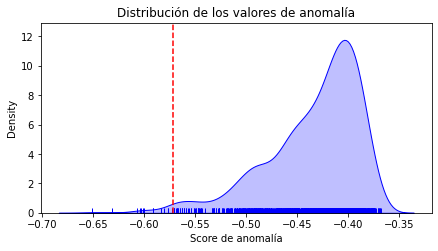

In [15]:

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 3.5))
sns.distplot(
    score_anomalia,
    hist    = False,
    rug     = True,
    color   = 'blue',
    kde_kws = {'shade': True, 'linewidth': 1},
    ax      = ax
)

ax.axvline(modelo_isof.offset_, c='red', linestyle='--', label='cuantil 0.01')
ax.set_title('Distribución de los valores de anomalía')
ax.set_xlabel('Score de anomalía');

### Predicción

In [16]:
y_pred = modelo_isof.predict(X_test)
y_pred

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1, -1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1, -1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,
        1,  1,  1,  1,  1

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2056: FutureWarning: The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.
  warnings.warn(msg, FutureWarning)


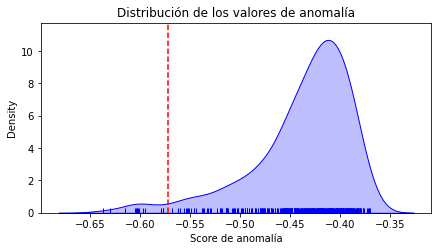

In [17]:
score_test = modelo_isof.score_samples(X=X_test)

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7, 3.5))
sns.distplot(
    score_test,
    hist    = False,
    rug     = True,
    color   = 'blue',
    kde_kws = {'shade': True, 'linewidth': 1},
    ax      = ax
)

ax.axvline(modelo_isof.offset_, c='red', linestyle='--', label='cuantil 0.01')
ax.set_title('Distribución de los valores de anomalía')
ax.set_xlabel('Score de anomalía');

## Taller


Con base en el proceso de aprendizaje a partir de datos, resuelva los problemas que se presentan a continuación:

**1)** Un aspecto importante en contextos relacionados con marketing es conocer a los usuarios para poder desarrollar campañas personalizadas. Para obtener este conocimiento, una de las técnicas más utilizadas es realizar una segmentación de los clientes, a través de algoritmos de agrupación, para obtener perfiles o patrones de comportamiento. El caso que se quiere desarrollar está relacionado con un conjunto de datos que resume el uso de tarjetas de crédito de aproximadamente 9000 titulares activos durante los últimos 6 meses.

Construya un modelo de agrupación que permita identificar perfiles de compra utilizando el algoritmo K-medias. Utilice el coeficiente de silueta como criterio de evaluación y realice la interpretación de los grupos obtenidos.

**Conjunto de datos:** “credit_card”.

**2)** Uno de los peligros inherentes a la actividad minera es la amenaza sísmica que ocurre con frecuencia en muchas minas subterráneas. Los factores que influyen en la naturaleza de estos eventos son muy diversos, y las relaciones entre estos factores son muy complejas y muy poco conocidas. Los métodos utilizados hasta ahora para anticipar la actividad sísmica peligrosa no cubren las necesidades en este sector, ya que resultan insuficientes para lograr una buena sensibilidad. Como alternativa, se ha planteado verificar si los métodos de machine learning pueden ser capaces de detectar eventos sísmicos peligrosos. En un primer intento, se desea aplicar técnicas de detección de anomalías para realizar esta tarea.

**Conjunto de datos:** “seismic-bumps”. El algoritmo de detección de anomalías queda a su elección. (Recomendación: utilizar el conocimiento del dominio reflejado en el artículo de los autores “Application of rule induction algorithms for analysis of data collected by seismic hazard monitoring systems in coal mines”).